In [150]:
import pandas as pd
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns
from mplsoccer import Pitch, VerticalPitch
from matplotlib.colors import LinearSegmentedColormap

In [276]:
df = pd.read_csv('Expected Goals Model.csv')

In [278]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [280]:
df.head(10)

,x,y,is_goal,period,Assisted,Zone,IndividualPlay,RegularPlay,LeftFoot,RightFoot,FromCorner,FirstTouch,Head,BigChance,SetPiece,Volley,FastBreak,ThrowinSetPiece,Penalty,OneOnOne,KeyPass,DirectFreekick,OwnGoal,OtherBodyPart,DirectCorner
0,80.8,51.6,False,SecondHalf,True,Center,True,True,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,79.3,24.2,False,SecondHalf,True,Center,True,True,NaN,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,80.0,59.5,False,SecondHalf,True,Center,NaN,NaN,NaN,True,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,89.8,55.6,False,SecondHalf,True,Center,NaN,NaN,NaN,NaN,True,True,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,84.9,56.2,False,SecondHalf,True,Center,NaN,True,True,NaN,NaN,NaN,NaN,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,88.2,57.0,False,SecondHalf,True,Center,NaN,True,True,NaN,NaN,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,76.8,56.4,False,SecondHalf,True,Center,True,True,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,87.9,68.2,False,SecondHalf,True,Center,True,True,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,91.9,48.8,False,SecondHalf,True,Center,NaN,True,NaN,NaN,NaN,True,True,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,75.0,51.9,False,SecondHalf,True,Center,True,True,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [281]:
df = df.rename(columns = {'is_goal':'Is_Goal'})

In [282]:
df.head(5)

,x,y,Is_Goal,period,Assisted,Zone,IndividualPlay,RegularPlay,LeftFoot,RightFoot,FromCorner,FirstTouch,Head,BigChance,SetPiece,Volley,FastBreak,ThrowinSetPiece,Penalty,OneOnOne,KeyPass,DirectFreekick,OwnGoal,OtherBodyPart,DirectCorner
0,80.8,51.6,False,SecondHalf,True,Center,True,True,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,79.3,24.2,False,SecondHalf,True,Center,True,True,NaN,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,80.0,59.5,False,SecondHalf,True,Center,NaN,NaN,NaN,True,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,89.8,55.6,False,SecondHalf,True,Center,NaN,NaN,NaN,NaN,True,True,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,84.9,56.2,False,SecondHalf,True,Center,NaN,True,True,NaN,NaN,NaN,NaN,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [284]:
df.shape

(8118, 25)

In [285]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8118 entries, 0 to 8117
Data columns (total 25 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   x                8118 non-null   float64
 1   y                8118 non-null   float64
 2   Is_Goal          8118 non-null   bool   
 3   period           8118 non-null   object 
 4   Assisted         6038 non-null   object 
 5   Zone             8118 non-null   object 
 6   IndividualPlay   2802 non-null   object 
 7   RegularPlay      5390 non-null   object 
 8   LeftFoot         2791 non-null   object 
 9   RightFoot        3994 non-null   object 
 10  FromCorner       1194 non-null   object 
 11  FirstTouch       3925 non-null   object 
 12  Head             1300 non-null   object 
 13  BigChance        1607 non-null   object 
 14  SetPiece         393 non-null    object 
 15  Volley           810 non-null    object 
 16  FastBreak        616 non-null    object 
 17  ThrowinSetPiec

In [286]:
df.describe()

,x,y
count,8118.000000,8118.000000
mean,85.538987,50.036056
std,8.770946,12.207702
min,0.800000,3.100000
25%,80.500000,41.300000
50%,87.200000,50.000000
75%,91.200000,58.700000
max,99.600000,99.600000


In [287]:
px.histogram(df, x = 'Penalty', color = 'Is_Goal')

C:\Users\risha\anaconda3\lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [288]:
px.histogram(df, x = 'Zone', color = 'Is_Goal')

C:\Users\risha\anaconda3\lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [289]:
df.x.max()

99.6

In [290]:
df.x.min()

0.8

In [292]:
df.y.max()

99.6

In [293]:
df.y.min()

3.1

In [295]:
df.columns

Index(['x', 'y', 'Is_Goal', 'period', 'Assisted', 'Zone', 'IndividualPlay',
       'RegularPlay', 'LeftFoot', 'RightFoot', 'FromCorner', 'FirstTouch',
       'Head', 'BigChance', 'SetPiece', 'Volley', 'FastBreak',
       'ThrowinSetPiece', 'Penalty', 'OneOnOne', 'KeyPass', 'DirectFreekick',
       'OwnGoal', 'OtherBodyPart', 'DirectCorner'],
      dtype='object')

In [296]:
df.DirectFreekick.value_counts()

DirectFreekick
True    231
Name: count, dtype: int64

In [297]:
df.DirectCorner.value_counts()

DirectCorner
True    2
Name: count, dtype: int64

In [298]:
#df.drop(['DirectFreekick', 'DirectCorner'], axis = 1, inplace = True)

In [301]:
df.shape

(8118, 25)

In [302]:
df = df[df['OwnGoal'] != True]

In [304]:
df.drop(['OwnGoal'], axis = 1, inplace = True)

In [305]:
df.shape

(8091, 24)

In [307]:
df.Is_Goal.value_counts()

Is_Goal
False    7097
True      994
Name: count, dtype: int64

<Axes: xlabel='x', ylabel='y'>

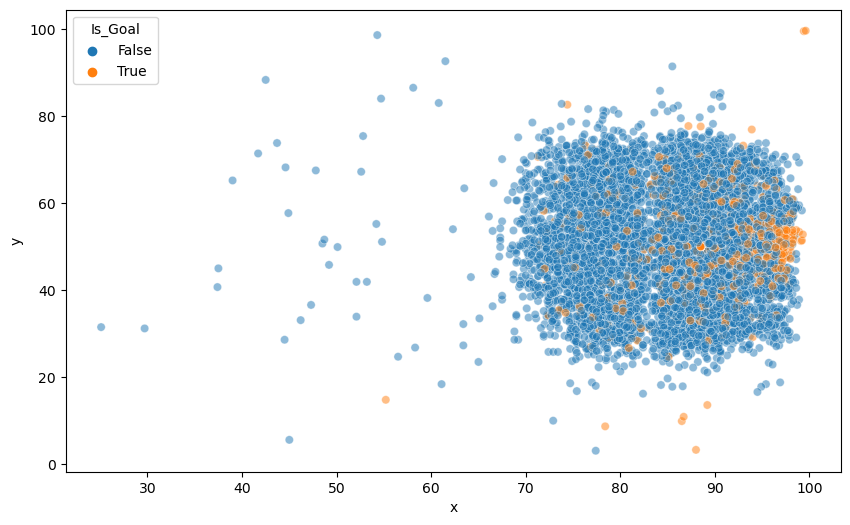

In [308]:
plt.figure(figsize = (10,6))

sns.scatterplot(data = df, x = 'x', y = 'y', hue = 'Is_Goal', alpha = 0.5)

In [309]:
df.isna().sum()

x                     0
y                     0
Is_Goal               0
period                0
Assisted           2053
Zone                  0
IndividualPlay     5289
RegularPlay        2714
LeftFoot           5307
RightFoot          4106
FromCorner         6903
FirstTouch         4166
Head               6793
BigChance          6484
SetPiece           7704
Volley             7281
FastBreak          7476
ThrowinSetPiece    7904
Penalty            7985
OneOnOne           7890
KeyPass            8033
DirectFreekick     7860
OtherBodyPart      8067
DirectCorner       8089
dtype: int64

In [310]:
df.fillna(0, inplace = True)

In [393]:
df

,x,y,Is_Goal,Assisted,IndividualPlay,RegularPlay,LeftFoot,RightFoot,FromCorner,FirstTouch,Head,BigChance,SetPiece,Volley,FastBreak,ThrowinSetPiece,Penalty,OneOnOne,KeyPass,DirectFreekick,OtherBodyPart,DirectCorner,Shot_Distance,period_FirstHalf,period_SecondHalf,Zone_Back,Zone_Center,Zone_Left,Zone_Right
0,80.8,51.6,False,True,True,True,True,False,False,False,False,False,False,False,False,False,False,False,False,0,False,0,19.266551,False,True,False,True,False,False
1,79.3,24.2,False,True,True,True,False,True,False,False,False,False,False,False,False,False,False,False,False,0,False,0,33.077636,False,True,False,True,False,False
2,80.0,59.5,False,True,False,False,False,True,True,False,False,False,False,False,False,False,False,False,False,0,False,0,22.141590,False,True,False,True,False,False
3,89.8,55.6,False,True,False,False,False,False,True,True,True,False,False,False,False,False,False,False,False,0,False,0,11.636151,False,True,False,True,False,False
4,84.9,56.2,False,True,False,True,True,False,False,False,False,True,False,False,False,False,False,False,False,0,False,0,16.323296,False,True,False,True,False,False
5,88.2,57.0,False,True,False,True,True,False,False,True,False,False,False,False,False,False,False,False,False,0,False,0,13.720058,False,True,False,True,False,False
6,76.8,56.4,False,True,True,True,True,False,False,False,False,False,False,False,False,False,False,False,False,0,False,0,24.066574,False,True,False,True,False,False
7,87.9,68.2,False,True,True,True,True,False,False,False,False,False,False,False,False,False,False,False,False,0,False,0,21.855205,False,True,False,True,False,False
8,91.9,48.8,False,True,False,True,False,False,False,True,True,True,False,False,False,False,False,False,False,0,False,0,8.188406,False,True,False,True,False,False
9,75.0,51.9,False,True,True,True,True,False,False,False,False,False,False,False,False,False,False,False,False,0,False,0,25.072096,False,True,False,True,False,False


In [311]:
df.dtypes

x                  float64
y                  float64
Is_Goal               bool
period              object
Assisted            object
Zone                object
IndividualPlay      object
RegularPlay         object
LeftFoot            object
RightFoot           object
FromCorner          object
FirstTouch          object
Head                object
BigChance           object
SetPiece            object
Volley              object
FastBreak           object
ThrowinSetPiece     object
Penalty             object
OneOnOne            object
KeyPass             object
DirectFreekick      object
OtherBodyPart       object
DirectCorner        object
dtype: object

In [312]:
df = df.astype({
    'x': float,
    'y': float,
    'Is_Goal': bool,
    'period': str,
    'Assisted': bool,
    'Zone': str,
    'IndividualPlay':bool,
    'RegularPlay':bool,
    'LeftFoot':bool,
    'RightFoot':bool,
    'FromCorner':bool,
    'FirstTouch':bool, 
    'Head':bool,
    'BigChance': bool,
    'SetPiece': bool,
    'Volley': bool,
    'FastBreak':bool,
    'ThrowinSetPiece':bool,
    'Penalty':bool, 
    'OneOnOne':bool,
    'KeyPass': bool,
    'OtherBodyPart': bool
})

In [313]:
df.dtypes

x                  float64
y                  float64
Is_Goal               bool
period              object
Assisted              bool
Zone                object
IndividualPlay        bool
RegularPlay           bool
LeftFoot              bool
RightFoot             bool
FromCorner            bool
FirstTouch            bool
Head                  bool
BigChance             bool
SetPiece              bool
Volley                bool
FastBreak             bool
ThrowinSetPiece       bool
Penalty               bool
OneOnOne              bool
KeyPass               bool
DirectFreekick      object
OtherBodyPart         bool
DirectCorner        object
dtype: object

In [314]:
#SHOT DISTANCE - Euclidean Distance.

df['Shot_Distance'] = np.sqrt((df['x'] - 100) ** 2 + (df['y'] - 50) ** 2)

#This line of code calculates the Euclidean distance of a shot from the center of the goal (usually at (100, 50) on an OPTA-style pitch).

#df['x'] and df['y'] → Coordinates of the shot on the pitch.
#Goal center coordinates → (100, 50) (assuming the pitch is 100 x 100 units with the goal at the top center).
#np.sqrt() → Calculates the square root using NumPy.

#Measures the straight-line distance between the shot position and the goal center.
#Helps in calculating xG (Expected Goals) since shot distance is a key factor in scoring probability.

In [324]:
df.Shot_Distance

0       19.266551
1       33.077636
2       22.141590
3       11.636151
4       16.323296
5       13.720058
6       24.066574
7       21.855205
8        8.188406
9       25.072096
10      27.575714
11       9.500526
12       8.504117
13       9.144397
14      28.101601
15      20.573041
16      16.500000
17      14.320964
18      12.709445
19       9.037699
20      17.600568
21      23.122500
22      25.040966
23      16.585837
24      23.361721
25      33.769957
26      19.181762
27      25.811819
28      15.338840
29       4.386342
30      23.659670
31      16.512420
32      10.360019
33      11.798729
34      17.983604
35      27.888349
36      31.517931
37       9.091755
38      24.646501
39      14.384019
40      16.676930
41      29.842922
42      12.472369
43       8.472308
44      13.671869
45      19.709135
46      27.245917
47      27.548503
48      21.518829
49      27.596014
50      11.500000
51       9.684007
52      14.415617
53      27.819597
54      11.510864
55      26

<Axes: >

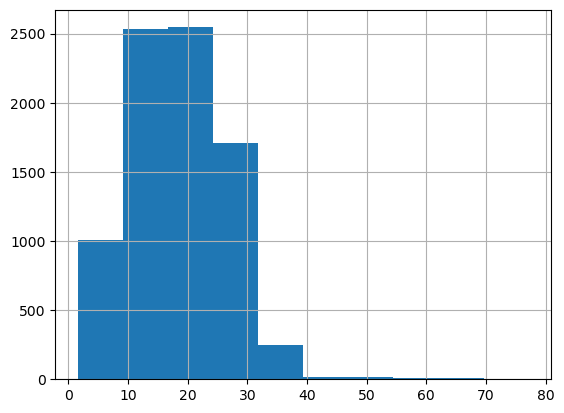

In [325]:
df['Shot_Distance'].hist()

In [326]:
df['Shot_Distance'].describe()

count    8091.000000
mean       18.495064
std         8.011289
min         1.581139
25%        12.061300
50%        18.380696
75%        24.200207
max        77.150891
Name: Shot_Distance, dtype: float64

In [327]:
df.period.value_counts()

period
SecondHalf    4333
FirstHalf     3758
Name: count, dtype: int64

In [328]:
df = pd.get_dummies(df, columns = ['period', 'Zone'])

#pandas.get_dummies() performs one-hot encoding on the 'period' and 'Zone' columns of the df DataFrame.

#Categorical data (like 'period' and 'Zone') cannot be directly used in machine learning models — they need to be converted into numerical values.
#pd.get_dummies() creates new binary columns for each unique category in the specified columns.
#For each row, it assigns a 1 or 0 depending on whether the row belongs to that category.

In [329]:
df.columns

Index(['x', 'y', 'Is_Goal', 'Assisted', 'IndividualPlay', 'RegularPlay',
       'LeftFoot', 'RightFoot', 'FromCorner', 'FirstTouch', 'Head',
       'BigChance', 'SetPiece', 'Volley', 'FastBreak', 'ThrowinSetPiece',
       'Penalty', 'OneOnOne', 'KeyPass', 'DirectFreekick', 'OtherBodyPart',
       'DirectCorner', 'Shot_Distance', 'period_FirstHalf',
       'period_SecondHalf', 'Zone_Back', 'Zone_Center', 'Zone_Left',
       'Zone_Right'],
      dtype='object')

In [330]:
df.period_FirstHalf.value_counts()

period_FirstHalf
False    4333
True     3758
Name: count, dtype: int64

In [333]:
df.period_SecondHalf.value_counts()

period_SecondHalf
True     4333
False    3758
Name: count, dtype: int64

In [334]:
inputs = df.drop('Is_Goal', axis = 1)
targets = df['Is_Goal']

In [337]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import log_loss, roc_auc_score, brier_score_loss

In [339]:
train_inputs, test_inputs, train_targets, test_targets = train_test_split(inputs, targets, test_size = 0.2, random_state = 42)

#inputs → Feature matrix (independent variables)
#targets → Target values (dependent variable)

#train_test_split() → Splits the data into:
#train_inputs → Training data (features)
#test_inputs → Test data (features)
#train_targets → Training data (targets)
#test_targets → Test data (targets)

#test_size=0.2 - 20% of the data is assigned to the test set, 80% to the training set.
#random_state = 42 - Ensures reproducibility, the split will be the same every time the code runs.

In [341]:
train_inputs

,x,y,Assisted,IndividualPlay,RegularPlay,LeftFoot,RightFoot,FromCorner,FirstTouch,Head,BigChance,SetPiece,Volley,FastBreak,ThrowinSetPiece,Penalty,OneOnOne,KeyPass,DirectFreekick,OtherBodyPart,DirectCorner,Shot_Distance,period_FirstHalf,period_SecondHalf,Zone_Back,Zone_Center,Zone_Left,Zone_Right
5416,88.6,60.5,True,False,True,False,True,False,False,False,True,False,False,False,False,False,False,False,0,False,0,15.498710,True,False,False,True,False,False
6239,74.3,59.4,False,True,False,False,True,True,False,False,False,False,True,False,False,False,False,False,0,False,0,27.365124,False,True,False,True,False,False
4387,76.9,42.5,True,True,True,False,True,False,False,False,False,False,False,False,False,False,False,False,0,False,0,24.287034,False,True,False,True,False,False
1708,88.7,54.8,True,True,True,True,False,False,False,False,False,False,False,False,False,False,False,False,0,False,0,12.277215,True,False,False,True,False,False
1726,77.8,55.5,False,True,False,True,False,True,True,False,False,False,True,False,False,False,False,False,0,False,0,22.871161,True,False,False,True,False,False
373,87.1,56.6,True,True,True,False,True,False,True,False,False,False,True,False,False,False,False,False,0,False,0,14.490342,False,True,False,True,False,False
6296,80.0,66.4,True,False,False,False,True,True,False,False,False,False,False,False,False,False,False,False,0,False,0,25.864261,True,False,False,True,False,False
5861,89.1,47.6,True,False,False,True,False,False,True,False,False,False,True,True,False,False,False,False,0,False,0,11.161093,False,True,False,True,False,False
6317,89.0,47.4,True,False,False,False,True,False,True,False,False,False,True,False,True,False,False,False,0,False,0,11.303097,True,False,False,True,False,False
2902,92.9,54.6,True,False,False,False,True,True,True,False,True,False,True,False,False,False,False,False,0,False,0,8.459905,True,False,False,True,False,False


In [342]:
train_inputs.shape

(6472, 28)

In [360]:
train_targets

5416    False
6239    False
4387    False
1708    False
1726    False
373     False
6296    False
5861    False
6317    False
2902    False
5425    False
7325    False
1736    False
2506    False
2726    False
7810    False
5890    False
3221    False
3373    False
1812    False
1396    False
814      True
7235    False
7984    False
5322    False
7296    False
2954    False
3307    False
7737    False
6071    False
5147    False
5713    False
2036    False
4654    False
1742    False
1734    False
923     False
322     False
3007    False
7941    False
6269    False
5644    False
2736     True
4549    False
3563    False
3915    False
231     False
2785    False
110     False
7129    False
1081    False
6562     True
1117    False
8059    False
6823    False
1472    False
4141    False
4204    False
1583     True
3679    False
2479    False
4659    False
2428    False
1455    False
2120    False
4575    False
2062    False
2562    False
4596     True
6710    False
3947    False
2631  

In [361]:
train_targets.shape

(6472,)

In [362]:
model = LogisticRegression(max_iter = 1000)

#In LogisticRegression, the max_iter parameter controls the maximum number of iterations the model will take to converge (find the optimal solution).

#How Logistic Regression Works:
#Logistic Regression uses an optimization algorithm (usually Gradient Descent or a variant) to minimize the log loss (cost function).
#The algorithm updates the model's weights step-by-step until the cost function stops improving significantly (i.e., converges).
#If the algorithm takes too long to converge, increasing max_iter allows more iterations to reach convergence.

#Explanation of max_iter:
#ax_iter = 1000 → The model will perform up to 1000 iterations of weight updates.
#If the model converges before 1000 iterations, it will stop early.
#If the model does not converge within 1000 iterations, it will stop and may give a ConvergenceWarning.

#When to adjust max_iter:
#If the model fails to converge (shows a ConvergenceWarning), increase max_iter.
#If the dataset is large or features are highly correlated, more iterations may be needed.
#If the model is converging too slowly, try scaling the data or adjusting the learning rate (solver parameter).

In [363]:
model.fit(train_inputs, train_targets)

LogisticRegression(max_iter=1000)

In [364]:
test_probability = model.predict_proba(test_inputs)[:,1]

#This line extracts the predicted probabilities for the positive class (class 1) from the model (or any classification model that supports predict_proba).

#model.predict_proba(test_inputs) returns a 2D array of shape (n_samples, n_classes) containing the predicted probabilities for each class.

#[:, 1] selects the probability of the positive class (class 1).
#The first column ([:, 0]) would be the probability for the negative class (class 0).


In [365]:
test_probability[:10]

array([0.07203142, 0.35763373, 0.03649718, 0.03665087, 0.09971519,
       0.03725767, 0.0332539 , 0.0468293 , 0.04504808, 0.03880812])

In [366]:
final_df = test_inputs.copy()
final_df['Goal_Probability'] = test_probability

In [367]:
final_df

,x,y,Assisted,IndividualPlay,RegularPlay,LeftFoot,RightFoot,FromCorner,FirstTouch,Head,BigChance,SetPiece,Volley,FastBreak,ThrowinSetPiece,Penalty,OneOnOne,KeyPass,DirectFreekick,OtherBodyPart,DirectCorner,Shot_Distance,period_FirstHalf,period_SecondHalf,Zone_Back,Zone_Center,Zone_Left,Zone_Right,Goal_Probability
4208,87.0,56.4,True,False,True,False,True,False,True,False,False,False,False,False,False,False,False,False,0,False,0,14.489997,False,True,False,True,False,False,0.072031
4180,97.9,52.8,True,False,True,False,False,False,True,True,True,False,False,False,False,False,False,False,0,False,0,3.500000,False,True,False,True,False,False,0.357634
1933,97.0,41.9,True,False,False,False,False,True,True,True,False,False,False,False,False,False,False,False,0,False,0,8.637708,True,False,False,True,False,False,0.036497
1063,73.1,37.4,True,True,True,True,False,False,False,False,False,False,False,False,False,False,False,False,0,False,0,29.704713,True,False,False,True,False,False,0.036651
737,82.7,54.0,True,True,True,False,True,False,False,False,False,False,False,False,False,False,False,False,0,False,0,17.756407,False,True,False,True,False,False,0.099715
1386,76.8,66.0,False,True,True,True,False,False,True,False,False,False,False,False,False,False,False,False,0,False,0,28.182264,False,True,False,True,False,False,0.037258
743,69.6,43.1,True,True,True,False,True,False,False,False,False,False,False,False,False,False,False,False,0,False,0,31.173226,True,False,False,True,False,False,0.033254
503,77.7,64.9,False,True,True,False,True,False,False,False,False,False,False,False,False,False,False,False,0,False,0,26.819769,True,False,False,True,False,False,0.046829
233,76.5,63.6,True,True,True,False,True,False,False,False,False,False,False,False,False,False,False,False,0,False,0,27.151611,False,True,False,True,False,False,0.045048
5698,92.5,58.5,True,False,True,False,False,False,True,True,False,False,False,False,False,False,False,False,0,False,0,11.335784,False,True,False,True,False,False,0.038808


In [368]:
final_df.shape

(1619, 29)

In [369]:
final_df.iloc[500]

x                         94.0
y                         69.3
Assisted                  True
IndividualPlay           False
RegularPlay               True
LeftFoot                 False
RightFoot                 True
FromCorner               False
FirstTouch               False
Head                     False
BigChance                False
SetPiece                 False
Volley                   False
FastBreak                False
ThrowinSetPiece          False
Penalty                  False
OneOnOne                 False
KeyPass                  False
DirectFreekick               0
OtherBodyPart            False
DirectCorner                 0
Shot_Distance        20.211136
period_FirstHalf         False
period_SecondHalf         True
Zone_Back                False
Zone_Center               True
Zone_Left                False
Zone_Right               False
Goal_Probability      0.040328
Name: 1735, dtype: object

In [370]:
final_df.sort_values(by = 'Goal_Probability', ascending = False).head(10)

,x,y,Assisted,IndividualPlay,RegularPlay,LeftFoot,RightFoot,FromCorner,FirstTouch,Head,BigChance,SetPiece,Volley,FastBreak,ThrowinSetPiece,Penalty,OneOnOne,KeyPass,DirectFreekick,OtherBodyPart,DirectCorner,Shot_Distance,period_FirstHalf,period_SecondHalf,Zone_Back,Zone_Center,Zone_Left,Zone_Right,Goal_Probability
6619,88.5,50.0,False,False,False,True,False,False,False,False,True,False,False,False,False,True,False,False,0,False,0,11.5,False,True,False,True,False,False,0.832723
1323,88.5,50.0,False,False,False,True,False,False,False,False,True,False,False,False,False,True,False,False,0,False,0,11.5,False,True,False,True,False,False,0.832723
381,88.5,50.0,False,False,False,True,False,False,False,False,True,False,False,False,False,True,False,False,0,False,0,11.5,False,True,False,True,False,False,0.832723
3671,88.5,50.0,False,False,False,True,False,False,False,False,True,False,False,False,False,True,False,False,0,False,0,11.5,False,True,False,True,False,False,0.832723
473,88.5,50.0,False,False,False,True,False,False,False,False,True,False,False,False,False,True,False,False,0,False,0,11.5,True,False,False,True,False,False,0.829581
695,88.5,50.0,False,False,False,True,False,False,False,False,True,False,False,False,False,True,False,False,0,False,0,11.5,True,False,False,True,False,False,0.829581
5013,88.5,50.0,False,False,False,False,True,False,False,False,True,False,False,False,False,True,False,False,0,False,0,11.5,False,True,False,True,False,False,0.827015
50,88.5,50.0,False,False,False,False,True,False,False,False,True,False,False,False,False,True,False,False,0,False,0,11.5,False,True,False,True,False,False,0.827015
2978,88.5,50.0,False,False,False,False,True,False,False,False,True,False,False,False,False,True,False,False,0,False,0,11.5,False,True,False,True,False,False,0.827015
7387,88.5,50.0,False,False,False,False,True,False,False,False,True,False,False,False,False,True,False,False,0,False,0,11.5,False,True,False,True,False,False,0.827015


In [371]:
logloss = log_loss(test_targets, test_probability)
roc_auc = roc_auc_score(test_targets, test_probability)
brier_score = brier_score_loss(test_targets, test_probability)

print(f"Log Loss: {logloss}")
print(f"ROC AUC: {roc_auc}")
print(f"Brier Score: {brier_score}")

#LOG LOSS.
#Measures how close the predicted probabilities are to the actual binary labels (0 or 1).
#Also known as Logarithmic Loss or Cross-Entropy Loss.
#Closer to 0 = Better Predictions.
#Best Value = 0.

#ROC AUC SCORE.
#Stands for Area Under the Receiver Operating Characteristic Curve (ROC-AUC).
#Measures the ability of the model to separate the positive and negative classes.
#AUC = 0.5 → Model is no better than random guessing.
#AUC = 1 → Perfect separation of positive and negative classes.
#It works by plotting the True Positive Rate (TPR) vs. False Positive Rate (FPR) at different classification thresholds.
#Best Value = 1.

#BRIER SCORE.
#Measures the calibration of predicted probabilities — how close predicted probabilities are to the actual outcomes.
#Closer to 0 = better calibrated probabilities.
#A perfect model would have a Brier score of 0.
#Best Value = 0.

Log Loss: 0.26992545460574563
ROC AUC: 0.8098962278442661
Brier Score: 0.07749410932072871


In [372]:
pitch = Pitch(pitch_type = 'opta', pitch_color = '#F1E9E2', line_color = 'black', linewidth = 2, corner_arcs = 2)

In [373]:
colors = ['red', 'yellow', 'green']

cmap = LinearSegmentedColormap.from_list('my_colormap', colors)

#LinearSegmentedColormap → A Matplotlib class that creates a gradient-based colormap.
#.from_list() → Allows defining a colormap from a list of colors.
#'my_colormap' → Name of the custom colormap (can be any string).
#colors → A list of color values (can be in hex format #RRGGBB, named colors like 'red', or RGB tuples).

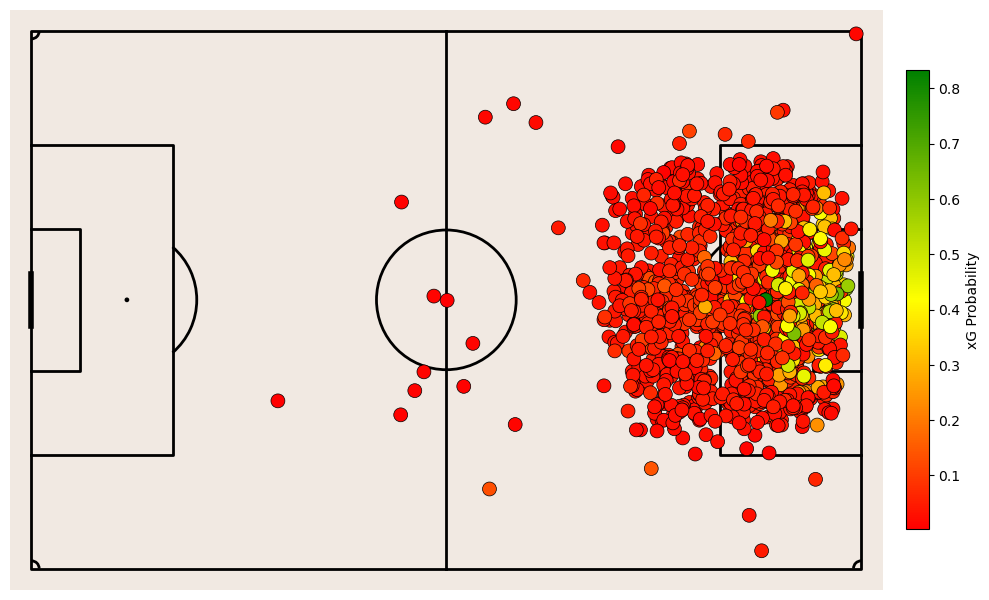

In [375]:
fig, ax = pitch.draw(figsize = (10,8))

sc = pitch.scatter(final_df['x'], final_df['y'], c = final_df['Goal_Probability'], cmap = cmap, edgecolors = 'black', linewidth = 0.5, s = 100, ax = ax)

cbar = plt.colorbar(sc, ax = ax, orientation = 'vertical', fraction = .025, pad = .025)
cbar.set_label('xG Probability')

#sc → The scatter plot object (or other mappable object).
#ax=ax → The axis to which the color bar is attached.
#orientation = 'vertical' → Displays the color bar vertically (set 'horizontal' for horizontal).
#fraction=0.025 → Controls the size of the color bar relative to the axis size (smaller value = smaller color bar).
#pad=0.025 → Sets the distance between the plot and the color bar.

#cbar.set_label('xG Probability') - Sets the label for the color bar → Explains what the color represents (in this case, xG Probability).